# Pancreatic endocrinogenesis

This tutorial uses raw data from [scvelo](https://github.com/theislab/scvelo) package. Special thanks go to the scvelo team! 

In [ ]:
# get the latest version from pypi 
# for other installations approaches, see https://dynamo-release.readthedocs.io/en/latest/ten_minutes_to_dynamo.html#how-to-install
!pip install dynamo-release --upgrade --quiet

In [1]:
# from IPython.core.display import display, HTML
# display(HTML("<style>.container { width:90% !important; }</style>"))
# %matplotlib inline
import warnings
warnings.filterwarnings('ignore')

import dynamo as dyn 

this is like R's sessionInfo()

In [2]:
dyn.get_all_dependencies_version()

package,colorcet,loompy,tqdm,dynamo-release,pynndescent,cvxopt,trimap,numdifftools,umap-learn,hdbscan,anndata,matplotlib,numba,pandas,python-igraph,scikit-learn,scipy,seaborn,statsmodels,numpy,setuptools
version,2.0.2,3.0.6,4.42.1,0.95.2,0.5.0,1.2.5,1.4.3.dev1,0.9.39,0.4.6,0.8.26,0.7.5,3.3.2,0.51.2,1.1.4,0.8.3,0.23.2,1.5.2,0.11.0,0.11.1,1.16.0,50.3.0


estimating gamma: 100%|██████████| 1000/1000 [00:40<00:00, 24.48it/s]
calculating transition matrix via pearson kernel with sqrt transform.: 100%|██████████| 3696/3696 [00:03<00:00, 945.20it/s]
projecting velocity vector to low dimensional embedding...: 100%|██████████| 3696/3696 [00:01<00:00, 3509.91it/s]


<Figure size 600x400 with 0 Axes>

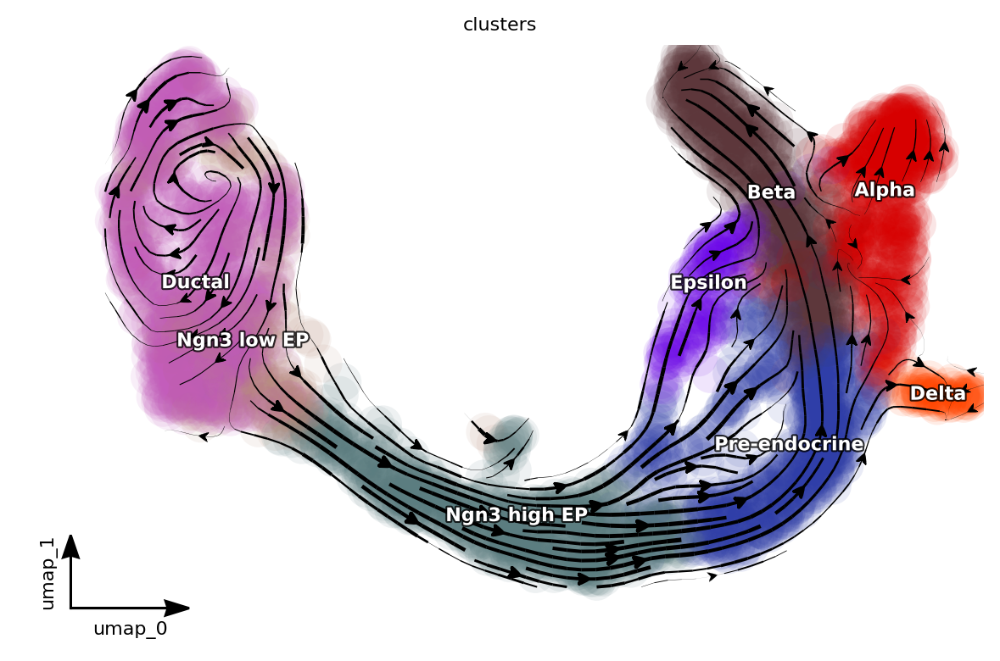

In [3]:
# run dynamo to get RNA velocity 

dyn.configuration.set_figure_params('dynamo', background='white')

adata = dyn.sample_data.pancreatic_endocrinogenesis()

dyn.pp.recipe_monocle(adata, n_top_genes=1000, fg_kwargs={'shared_count': 20})

dyn.tl.dynamics(adata, model='stochastic')

dyn.tl.reduceDimension(adata, n_pca_components=30)

dyn.tl.cell_velocities(adata, method='pearson', other_kernels_dict={'transform': 'sqrt'})
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap', show_legend='on data', show_arrowed_spines=True)


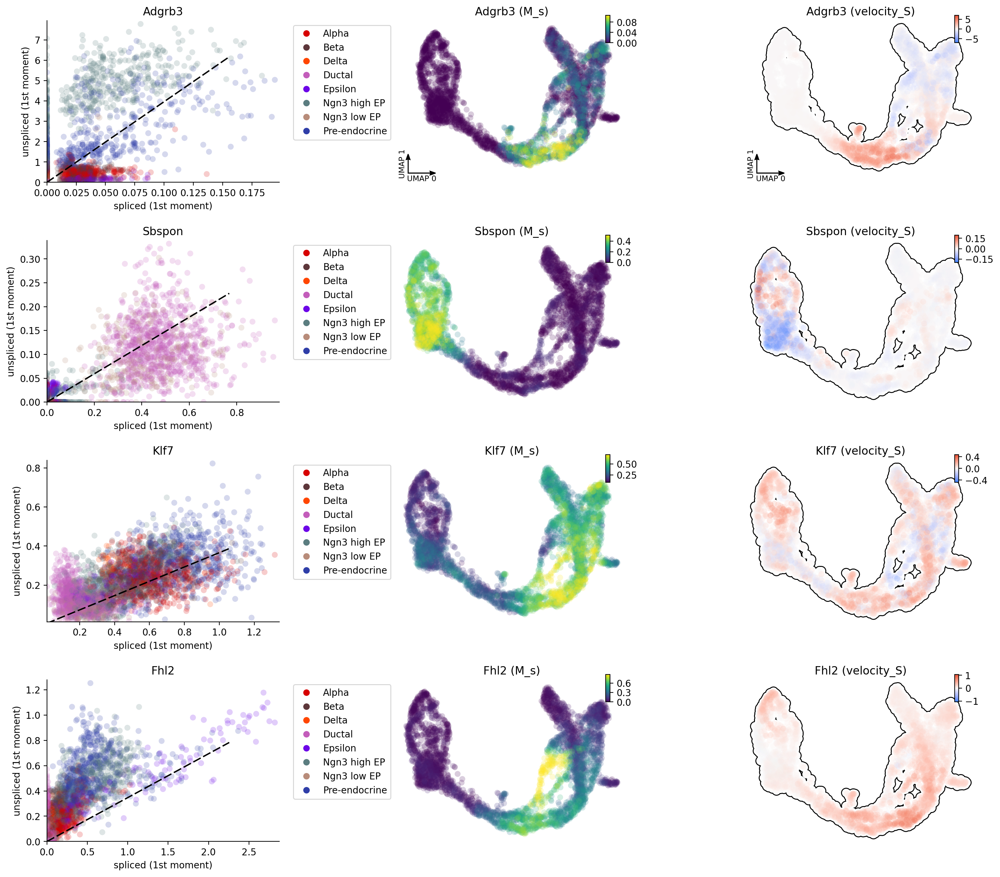

In [4]:
dyn.pl.phase_portraits(adata, genes=adata.var_names[adata.var.use_for_dynamics][:4], figsize=(6, 4), color='clusters')

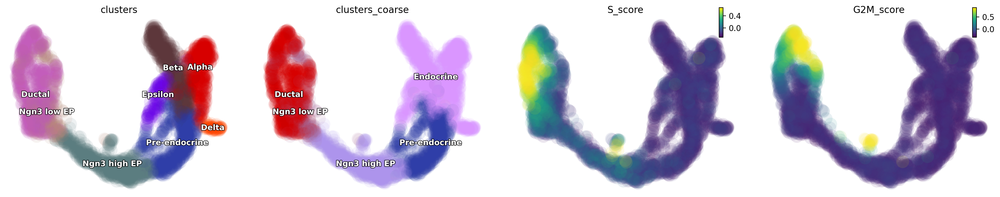

In [5]:
dyn.pl.umap(adata, color=['clusters', 'clusters_coarse', "S_score", "G2M_score"], ncols=4, alpha=0.1)

<Figure size 600x400 with 0 Axes>

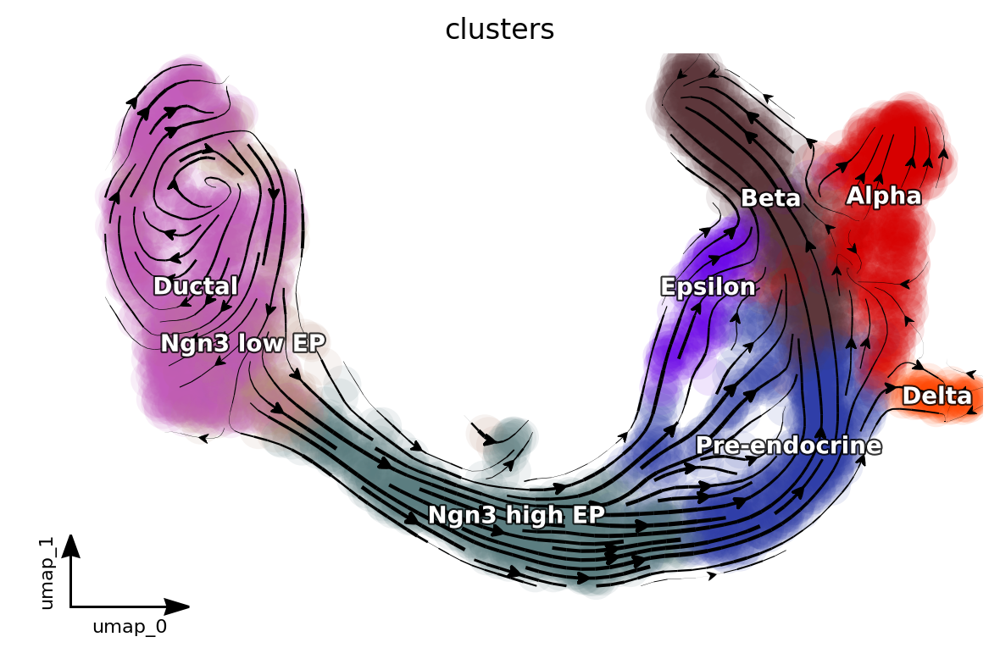

In [6]:
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap', show_legend='on data')


<Figure size 800x600 with 0 Axes>

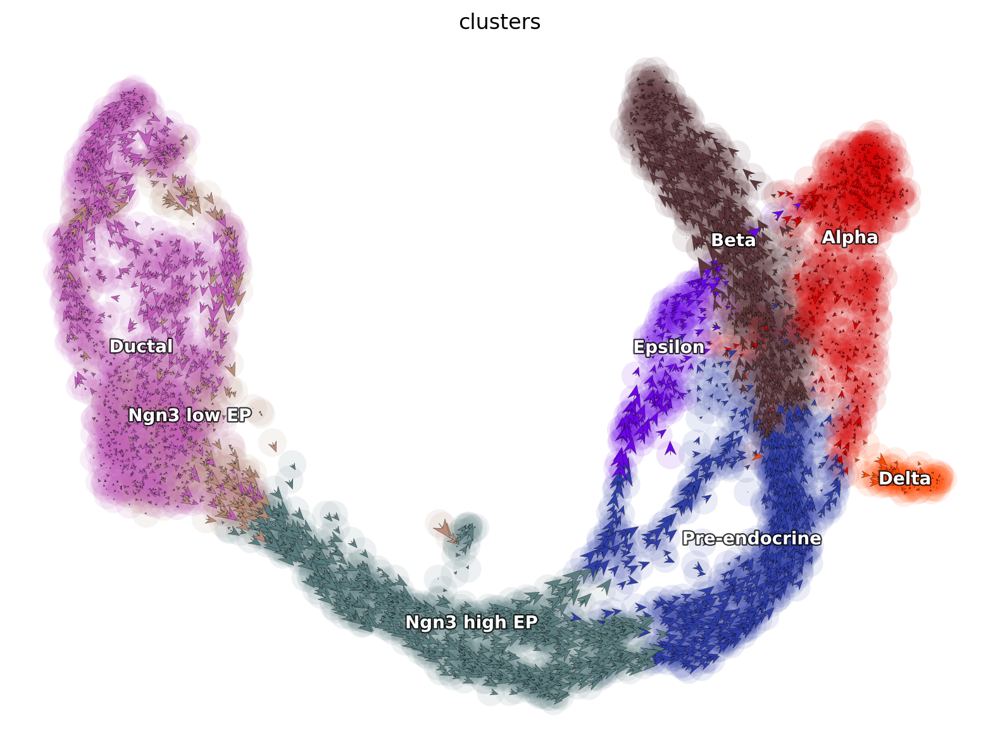

In [7]:
dyn.pl.cell_wise_vectors(adata, color=['clusters'], basis='umap', show_legend='on data', quiver_length=6, quiver_size=6, figsize=(8, 6), show_arrowed_spines=False)


In [8]:
# ok some exciting vector field analysis 

# you can set `verbose = 1/2/3` to obtain different levels of running information of vector field reconstruction

dyn.vf.VectorField(adata, basis='umap', pot_curl_div=True) # , M=1000, MaxIter=1000


Constructing diffusion graph from reconstructed vector field: 3696it [00:57, 64.52it/s]
Calculating divergence: 100%|██████████| 3696/3696 [00:00<00:00, 9943.50it/s]


AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_fit', 'feature_selection', 'dynamics', 'grid_vel

In [ ]:
dyn.pl.topography(adata, color=['clusters'], basis='umap', background='white', 
                  streamline_color='black', show_legend='on data', terms=("streamline"))


<Figure size 600x400 with 0 Axes>

In [ ]:
dyn.pl.topography(adata, basis='umap', background='white', color=['ntr', 'clusters'], streamline_color='black', show_legend='on data')


In [ ]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca')
dyn.vf.speed(adata)
dyn.vf.divergence(adata)
dyn.vf.acceleration(adata)
dyn.vf.curl(adata)

In [ ]:
adata

this just shows how flexible dynamo' plotting function can be. 

In [ ]:
import matplotlib.pyplot as plt
fig1, f1_axes = plt.subplots(ncols=2, nrows=2, constrained_layout=True, figsize=(12, 8))
f1_axes
f1_axes[0, 0] = dyn.pl.cell_wise_vectors(adata, color='umap_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0, 0], quiver_length=6, quiver_size=6, save_show_or_return='return')
f1_axes[0, 1] = dyn.pl.grid_vectors(adata, color='speed_umap', ax=f1_axes[0, 1], quiver_length=12, quiver_size=12, save_show_or_return='return')
f1_axes[1, 0] = dyn.pl.streamline_plot(adata, color='divergence_pca', ax=f1_axes[1, 0], save_show_or_return='return')
f1_axes[1, 1] = dyn.pl.streamline_plot(adata, color='acceleration_umap', ax=f1_axes[1, 1], save_show_or_return='return')
plt.show()

In [ ]:
# emulate ggplot2 plotting styple with black background
dyn.configuration.set_figure_params('dynamo', background='black')  

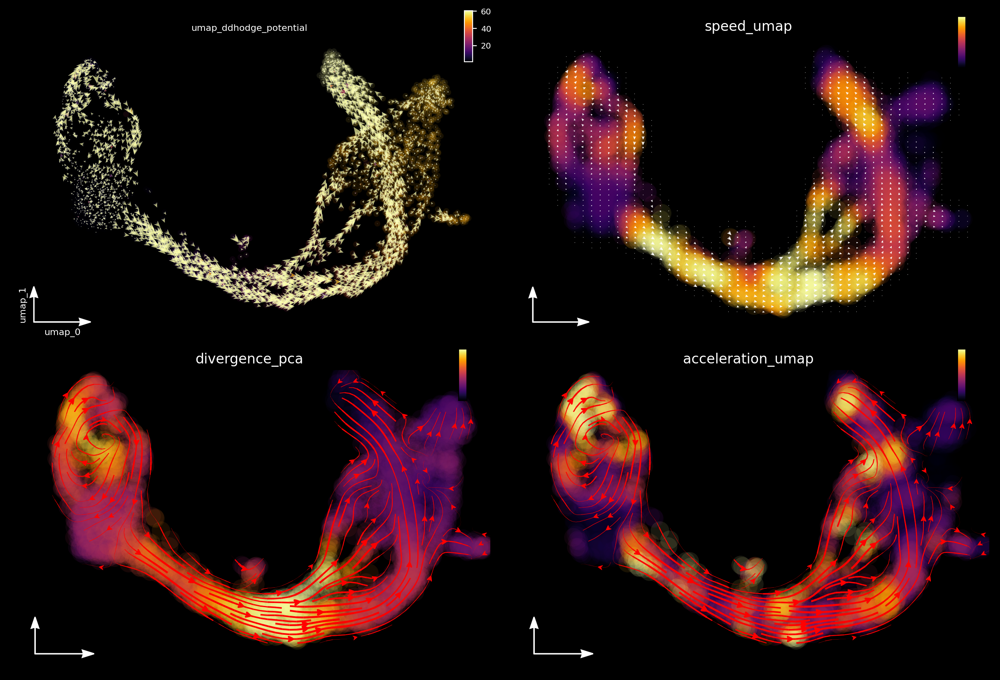

In [15]:
fig1, f1_axes = plt.subplots(ncols=2, nrows=2, constrained_layout=True, figsize=(12, 8))
f1_axes
f1_axes[0, 0] = dyn.pl.cell_wise_vectors(adata, color='umap_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0, 0], quiver_length=6, quiver_size=6, save_show_or_return='return', background='black')
f1_axes[0, 1] = dyn.pl.grid_vectors(adata, color='speed_umap', ax=f1_axes[0, 1], quiver_length=12, quiver_size=12, save_show_or_return='return', background='black')
f1_axes[1, 0] = dyn.pl.streamline_plot(adata, color='divergence_pca', ax=f1_axes[1, 0], save_show_or_return='return', background='black')
f1_axes[1, 1] = dyn.pl.streamline_plot(adata, color='acceleration_umap', ax=f1_axes[1, 1], save_show_or_return='return', background='black')
plt.show()

In [16]:
progenitor = adata.obs_names[adata.obs.clusters.isin(['Ductal'])]
len(progenitor)

916

In [17]:
import numpy as np 
dyn.pd.fate(adata, basis='umap', init_cells=np.random.choice(progenitor, 100), interpolation_num=100,  direction='forward',
   inverse_transform=False, average=False, cores=3)

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_umap', 'divergence_pca', 'acceleration_umap'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca'

In [18]:
%%capture
fig, ax = plt.subplots()
ax = dyn.pl.topography(adata, color='clusters', ax=ax, save_show_or_return='return')

In [19]:
%%capture
instance = dyn.mv.StreamFuncAnim(adata=adata, ax=ax, color='clusters')

In [20]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128 # Ensure all frames will be embedded. 

from matplotlib import animation
import numpy as np 

anim = animation.FuncAnimation(instance.fig, instance.update, init_func=instance.init_background,
                                frames=np.arange(100), interval=100, blit=True)
from IPython.core.display import display, HTML
HTML(anim.to_jshtml()) # embedding to jupyter notebook.

In [21]:
%%capture
fig, ax = plt.subplots()
ax = dyn.pl.topography(adata, color='clusters', ax=ax, save_show_or_return='return')
dyn.mv.animate_fates(adata, color='clusters', basis='umap', n_steps=200, fig=fig, ax=ax, 
                     save_show_or_return='save', logspace=True, max_time=None, save_kwargs={"filename": 'pancreas.gif'})


In [22]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca', pot_curl_div=True)


projecting velocity vector to low dimensional embedding...:   5%|▌         | 192/3696 [00:00<00:01, 1919.43it/s]

Using existing pearson_transition_matrix found in .obsp.


projecting velocity vector to low dimensional embedding...: 100%|██████████| 3696/3696 [00:01<00:00, 2624.57it/s]
Constructing diffusion graph from reconstructed vector field: 3696it [00:59, 62.33it/s]
Calculating divergence: 100%|██████████| 3696/3696 [00:00<00:00, 6281.35it/s]


AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_umap', 'divergence_pca', 'acceleration_umap', 'pca_ddhodge_div', 'pca_ddhodge_potential'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'cluste

In [23]:
dyn.vf.VectorField(adata, basis='umap', dims=[0, 1], M=adata.n_obs)


AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_umap', 'divergence_pca', 'acceleration_umap', 'pca_ddhodge_div', 'pca_ddhodge_potential'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'cluste

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

<Figure size 600x400 with 0 Axes>

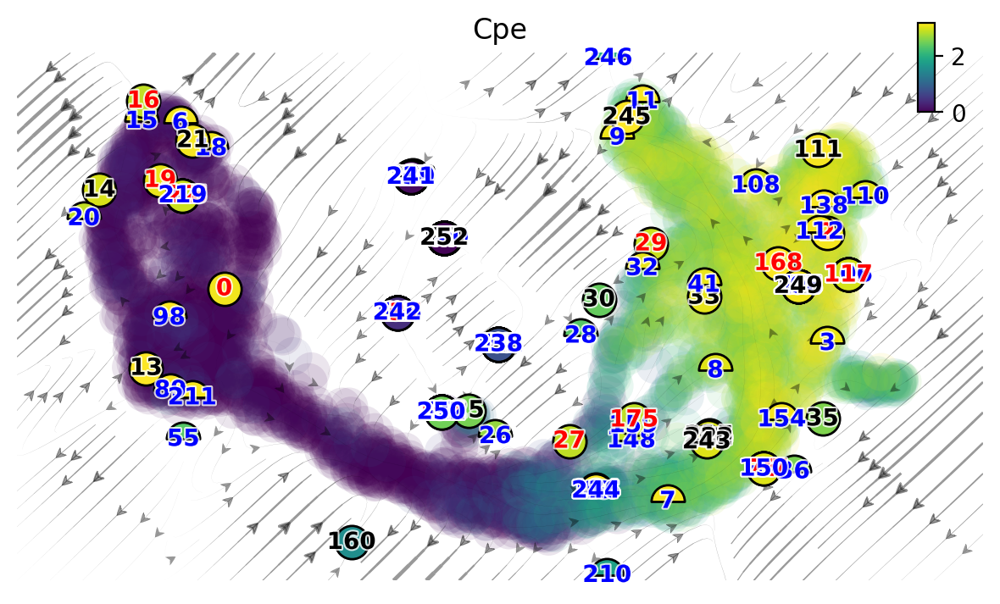

In [24]:
dyn.pl.topography(adata, color=['Cpe'], basis='umap')

In [25]:
dyn.pl.streamline_plot(adata, color=['Cpe'], basis='umap', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'pancreas_streamline', 'ext': 'png',
                                     "bbox_inches": None}, 
                        figsize=(3, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_streamline_dyn_savefig.png...
Done


<Figure size 300x300 with 0 Axes>

In [26]:
dyn.pl.phase_portraits(adata, genes=['Cpe'], basis='umap',
                       show_quiver=True,
                       background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, alpha = 0.7, quiver_length=10, quiver_size=6, 
                       save_kwargs={'prefix': 'pancreas_phase_portrait', 'ext': 'png',
                                     "bbox_inches": None}, 
                        figsize=(6, 4))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_phase_portrait_dyn_savefig.png...
Done


In [27]:
dyn.pl.topography(adata, color=['Cpe'], basis='umap', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'pancreas_topography', 'ext': 'png',
                                     "bbox_inches": None}, 
                        figsize=(3, 3))

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_topography_dyn_savefig.png...
Done


<Figure size 300x300 with 0 Axes>

In [28]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca', M=adata.n_obs, pot_curl_div=True)


projecting velocity vector to low dimensional embedding...:   7%|▋         | 268/3696 [00:00<00:01, 2674.23it/s]

Using existing pearson_transition_matrix found in .obsp.


projecting velocity vector to low dimensional embedding...: 100%|██████████| 3696/3696 [00:01<00:00, 3099.27it/s]
Calculating divergence: 100%|██████████| 3696/3696 [00:05<00:00, 648.03it/s]


AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_umap', 'divergence_pca', 'acceleration_umap', 'pca_ddhodge_div', 'pca_ddhodge_potential'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'cluste

In [29]:
adata

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_umap', 'divergence_pca', 'acceleration_umap', 'pca_ddhodge_div', 'pca_ddhodge_potential'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'cluste

In [30]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca')
dyn.vf.speed(adata, basis='pca')
dyn.vf.divergence(adata, basis='pca')
dyn.vf.acceleration(adata, basis='pca')
dyn.vf.curl(adata, basis='umap')

projecting velocity vector to low dimensional embedding...:  10%|▉         | 365/3696 [00:00<00:00, 3648.23it/s]

Using existing pearson_transition_matrix found in .obsp.


projecting velocity vector to low dimensional embedding...: 100%|██████████| 3696/3696 [00:01<00:00, 3643.15it/s]
Calculating 2-D curl: 100%|██████████| 3696/3696 [00:00<00:00, 5344.77it/s]


In [31]:
adata

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_umap', 'divergence_pca', 'acceleration_umap', 'pca_ddhodge_div', 'pca_ddhodge_potential', 'speed_pca', 'acceleration_pca'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_m', 'log_cv', 'score', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 

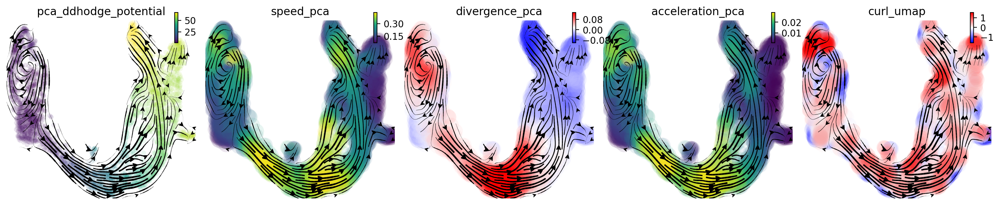

In [32]:
import matplotlib.pyplot as plt
fig1, f1_axes = plt.subplots(ncols=5, nrows=1, constrained_layout=True, figsize=(15, 3))
f1_axes
f1_axes[0] = dyn.pl.streamline_plot(adata, basis='umap', color='pca_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0], quiver_length=6, 
                                    quiver_size=6, save_show_or_return='return', show_arrowed_spines=False)
f1_axes[1] = dyn.pl.streamline_plot(adata, basis='umap', color='speed_pca', ax=f1_axes[1], quiver_length=12, quiver_size=12, save_show_or_return='return', 
                                    show_arrowed_spines=False)
f1_axes[2] = dyn.pl.streamline_plot(adata, basis='umap', color='divergence_pca', ax=f1_axes[2], save_show_or_return='return',
                                   show_arrowed_spines=False, cmap='bwr', sym_c=True)
f1_axes[3] = dyn.pl.streamline_plot(adata, basis='umap', color='acceleration_pca', ax=f1_axes[3], save_show_or_return='return', 
                                    show_arrowed_spines=False)
f1_axes[4] = dyn.pl.streamline_plot(adata, basis='umap', color='curl_umap', ax=f1_axes[4], save_show_or_return='return', 
                                    show_arrowed_spines=False, cmap='bwr', sym_c=True)
plt.savefig(dpi=300, fname='./pancreas_vector_calculus.png')


In [33]:
example_genes = ['Cpe']
import numpy as np 

dyn.pl.scatters(adata, x=np.repeat('pca_ddhodge_potential', 1),
                     y=example_genes, layer='X_spliced', color='pca_ddhodge_potential', 
                     background='white', figsize=(3, 3), save_show_or_return='save',
                     pointsize=0.4, ncols=1, alpha = 0.7, 
                     save_kwargs={'prefix': 'pancreas_potential', 'ext': 'png', "bbox_inches": None})

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/pancreas_potential_dyn_savefig.png...
Done


<Figure size 300x300 with 0 Axes>